# Revelation to Hierarchical nodes with Isopsephy

Libraries:

- http://etetoolkit.org/
- pysequitur
- textusreceptus


In [1]:
# pip install ete3
# conda install qt=4
# conda install pyqt
from ete3 import Tree, TreeStyle, NodeStyle, TextFace

In [2]:
from IPython.display import HTML
import textusreceptus as tr
import base64

Retrieving data from local csv copy...


In [19]:
def tree_style(rotation, roman=None):
    # define node/leaf modifier
    def rotate_labels(node):
        ns = NodeStyle()
        ns["size"] = 1
        if node.is_leaf():
            F = TextFace(roman(node.name).decode() if roman else node.name, fsize=14)
            F.rotation = rotation
            F.margin_right = F.margin_left = 2.0
            F.margin_bottom = 8.0
            node.add_face(F, 0, position="aligned")
        node.img_style = ns
    
    # init tree style
    ts = TreeStyle()
    # scale of the figure
    ts.scale = 10
    # remove default labels
    ts.show_leaf_name = False
    # hide scale
    ts.show_scale = False
    # rotate 90 degress counterclockwise
    ts.rotation = rotation
    # orient tree from left to right
    ts.orientation = 1
    # rotate labels
    ts.layout_fn = rotate_labels
    return ts

def get_tree(newick_str):
    # init tree
    return Tree(newick_str)

def branches(newick_str, rotation = -90, isopsephy = False, roman=None):
    def branch_isopsephy(node):
        F = TextFace("%s" % tr.isopsephy(''.join([str(leaf.name) for leaf in node.iter_leaves()])), fsize=10)
        F.rotation = rotation
        F.margin_bottom = 10.0
        node.add_face(F, 1, position="branch-right")
    
    def recur(node):
        branch_isopsephy(node)
        if node.children:
            for child in node.children:
                recur(child)
            
    # get tree instance
    t = get_tree(newick_str)
    branches = []
    for branch in t.children:
        if isopsephy:
            recur(branch)
        branches.append(branch.render("%%inline", tree_style=tree_style(rotation, roman)))
    # create inline display object from each tree branch
    return branches

def main(newick_str, isopsephy=False, height=150, roman=None):
    # iterate over all branches on a tree and base64 encode image data for the img tag
    imagesList = ''.join(['<div class="ete" style="height:'+str(height)+'px;float:left;border-right:#ccc dotted 1px;padding:0 5px"><img src="data:image/png;base64,%s" /></div>' 
                       % base64.b64encode(branch.data).decode() for branch in branches(newick_str, isopsephy=isopsephy, roman=roman)])
    # display on jupyter notebook cell
    return HTML(imagesList)

### Test nodes


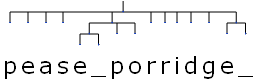
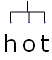
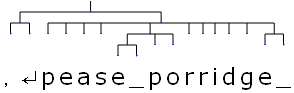
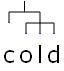
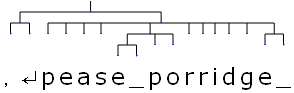
...
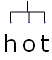
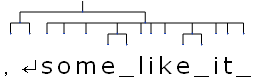
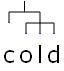
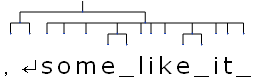
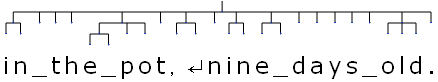

In [20]:
# init a newick string
newick_str = """((p, e, a, s, ((e, _), p, o), r, r, i, d, g, (e, _)), (h, o, t), ((，, ↵), (p, e, a, s, ((e, _), p, o), r, r, i, d, g, (e, _))), (c, (o, l, d)), ((，, ↵), (p, e, a, s, ((e, _), p, o), r, r, i, d, g, (e, _))), ((i, n), _, t, h, ((e, _), p, o), t, (，, ↵), n, (i, n), (e, _), d, a, y, s, _, (o, l, d), .), ↵, ↵, (s, o, m, (e, _), l, i, k, (e, _), i, t, _), (h, o, t), ((，, ↵), (s, o, m, (e, _), l, i, k, (e, _), i, t, _)), (c, (o, l, d)), ((，, ↵), (s, o, m, (e, _), l, i, k, (e, _), i, t, _)), ((i, n), _, t, h, ((e, _), p, o), t, (，, ↵), n, (i, n), (e, _), d, a, y, s, _, (o, l, d), .));"""
main(newick_str,height=50)

In [7]:
from pysequitur import Sequencer3 as Sequencer
from pysequitur.main import RuleIndex
import json

def flatten_list(items):
    """ List flattener helper function """
    for i, x in enumerate(items):
        while isinstance(items[i], list):
            items[i:i+1] = items[i]
    return items

def graph(self, fr = None, to = None, flatten = False):
    def _graph(rule):
        t1 = []
        l = len(rule)-1
        for items in [rule[i][0:(1 if i>-1 and i<l else 2)] for i in range(0,l+1)]:
            t1.extend(items)
        return t1
    def _recur(x):
        return [_recur(y) for y in _graph(self[x])] if isinstance(x, RuleIndex) else x
    return [flatten_list(_recur(x[1])) if flatten else _recur(x[1]) for x in self[0][fr:to]]

def graph(self, fr = None, to = None, flatten = False):
    def _graph(rule):
        t1 = []
        l = len(rule)-1
        for items in [rule[i][0:(1 if i>-1 and i<l else 2)] for i in range(0,l+1)]:
            t1.extend(items)
        return t1
    def _recur(x):
        return [_recur(y) for y in self[x]] if isinstance(x, RuleIndex) else x
    return [flatten_list(_recur(x)) if flatten else _recur(x) for x in self[0][fr:to]]

def to_ete_string(seq, fr = None, to = None, mp=False):
    g = graph(seq, fr, to)
    if mp:
        return json.dumps(list(map(str, g)), ensure_ascii=False).replace('[', '(').replace(']', ')')+";"
    return json.dumps(g, ensure_ascii=False).replace('[', '(').replace(']', ')').replace('"', '')+";"

In [40]:
string = open('revelation_characters.txt', 'r', encoding='utf8').read()[:]
s1 = Sequencer(string)


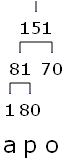
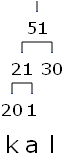
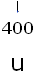
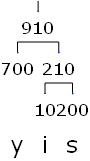
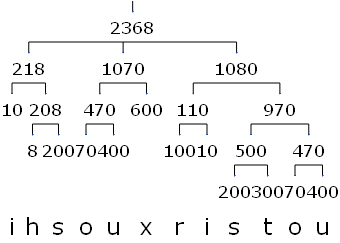
...
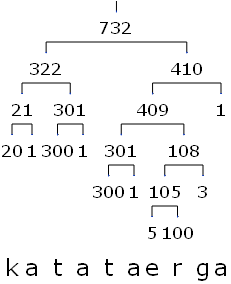
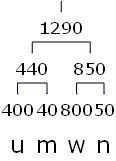
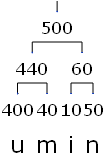
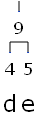
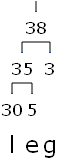

In [62]:
t = to_ete_string(s1.get(), 0, 1000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


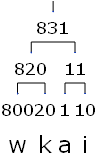
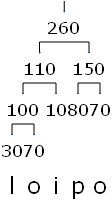
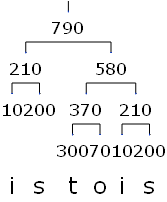
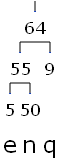
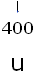
...
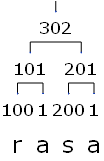
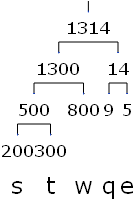
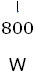
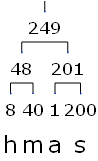
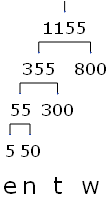

In [63]:
t = to_ete_string(s1.get(), 1000, 2000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


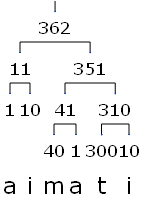
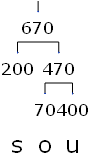
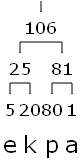
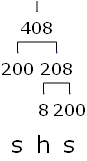
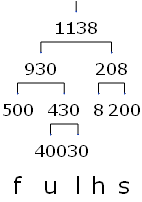
...
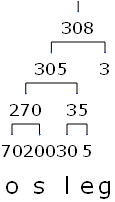
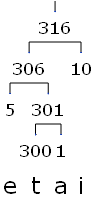
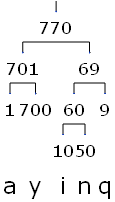
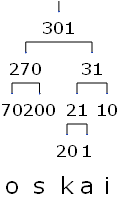
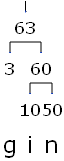

In [64]:
t = to_ete_string(s1.get(), 2000, 3000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


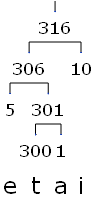
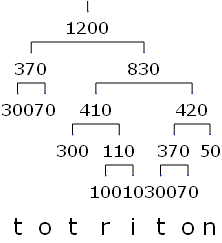
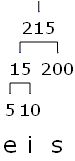
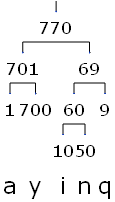
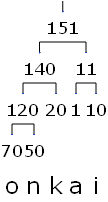
...
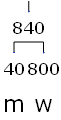
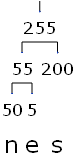
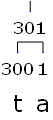
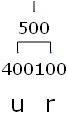
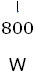

In [65]:
t = to_ete_string(s1.get(), 3000, 4000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


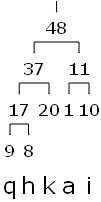
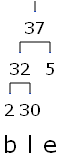
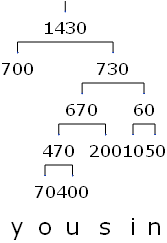
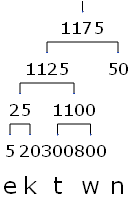
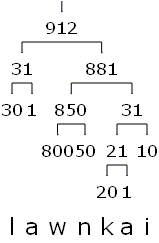
...
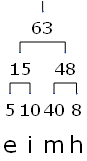
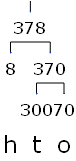
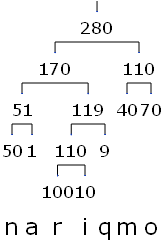
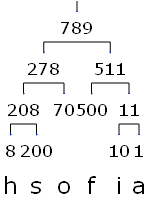
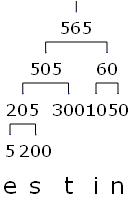

In [66]:
t = to_ete_string(s1.get(), 4000, 5000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


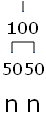
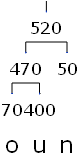
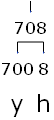
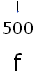
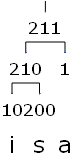
...
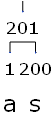
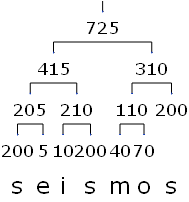
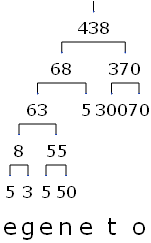
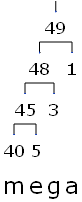
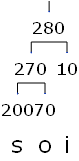

In [67]:
t = to_ete_string(s1.get(), 5000, 6000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


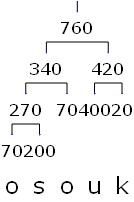
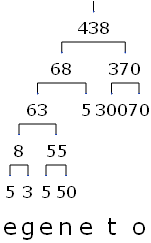
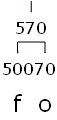
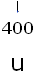
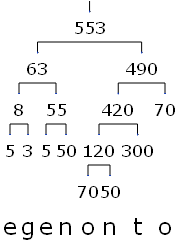
...
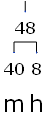
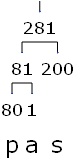
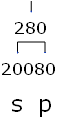
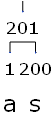
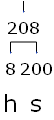

In [68]:
t = to_ete_string(s1.get(), 6000, 7000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


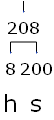
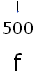
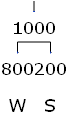
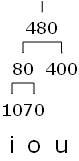
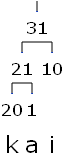
...
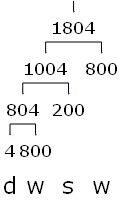
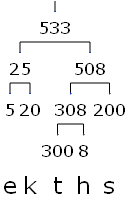
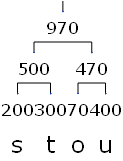
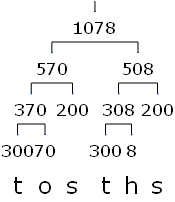
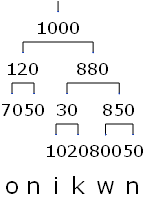

In [69]:
t = to_ete_string(s1.get(), 7000, 8000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)


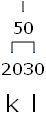
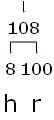
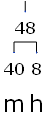
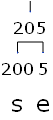
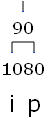
...
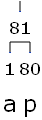
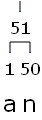
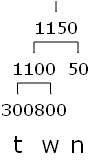
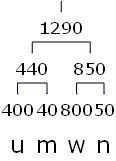
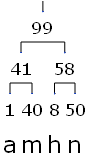

In [70]:
t = to_ete_string(s1.get(), 8000, 9000)
main(t, isopsephy=True, height=150, roman=tr.to_roman)

In [78]:
HTML("<style>.ete img {height:50%;width:50%}</style>")